# Kearney Advanced Analytics Case Study - WindFarm 
---

_Author: Tim Graf_

_Date: 24.02.2022_

# Executive Summary

In this Python Notebook I have shown outperformance for predicting the production sum of 20 wind farms using XGB as a model compared to both a simple and persistence model.

#### Data Analysis
I've looked at various dimensions to understand the data better. 

1. First I've realized how correlated all the assets are with each other and also, but less significantly, with the wind forecast. Hence, this may indiciate that the individual farms are located close to each other or the wind is very similar across the locations.

2. Second, I've identified clear yearly seasonality with summer months having less production than winter months. There is no such trend to be seen in daily or weekly averages. 

3. Third, there is a clear relationship between wind forecast and energy production. Beginning around 4-7.5 m/s energy is produced. The energy production cuts off at around 2.5MW, probably due to security reasons that a wind farm cannot produce more than a this threshold. 

4. Fourth, I've spotted outliers in form of negative or zero production despite high wind forecasts. This may be fore a variety of reasons such as malfunction of the sensor, maintenance or upgrade of the wind production asset, or wind forecasts. 

#### Feature Engineering

| Dataset A             | Dataset B                     |  Dataset C  | Dataset D |
| -----------          | -----------                    | -----------  | ----------- |
| 2 Wind Forecast      | 2 Wind Forecast                | 2 Wind Forecast | 2 Wind Forecast |
| 20 Wind Production   | 20 Wind Production - Cleaned   | 20 Wind Production - Cleaned | 20 Wind Production - Cleaned |
| -                    | -                              | Min, Max, Avg for each feature |  Min, Max, Avg for each feature |
| -                    | -         |  -         | Lagged Features & Rolling Means | 
| Datetime             | Datetime  | Datetime | Datetime | 


####  Models
Time Series can be analyzed using multiple methods: 

* Tradional Methods: 
    * Univariate Time Series: 
        * ARIMA
        * SARIMAX
        * Prophet (by Facebook)
    * Multivariate Time Series
        * VAR (Vector Autoregression)
        * Prophet (by Facebook)
* Machine Learning Methods: 
    * Neural Network Regressors
    * Bagging Regressors
    * Decision-Tree Regressions (e.g. Random Forest, XGBoost)

##### Reasoning for XGBoost
XGBoost has been used and proven to be better compared to simple persistence models in the context of wind production prediction. See for example: 

* Landry, M., Erlinger, T. P., Patschke, D., & Varrichio, C. (2016). Probabilistic gradient boosting machines for GEFCom2014 wind forecasting. International Journal of Forecasting, 32(3), 1061-1066.
* Cai, R., Xie, S., Wang, B., Yang, R., Xu, D., & He, Y. (2020). Wind speed forecasting based on extreme gradient boosting. IEEE Access, 8, 175063-175069. 

XGBoost has the benefits that it can
 a) handle missing data
 b) work well without normalization of data
 c) find non-linear relationships
 d) is computationally efficient
 e) works well with small datasets compared to Neural Networks.

##### Proceedure
I use both persistence as also simple linear regression as a benchmark model. Then I compare how my XGBoost performs based on the RMSE (root mean squared error) loss function compared to the benchmark models. Finally I compare the performance of my XGBoost with different datasets as inputs. 

#### Vector Autoregression
I have begun decomposing the time series to work with vector regression. Due to time reasons I have unfortunately not been able to complete it. Nevertheless I've attached the code. 


# Library Import

In [49]:
# It is recommended to set up a virtual environment
'''
python3 - m venv / path/to/new/virtual/environment
cd / path/to/new/virtual/environment
cd bin
source activate
'''

# install needed packages
'''pip3 install -r requirements.txt'''

'pip3 install -r requirements.txt'

In [50]:
import datetime
import glob
import sklearn
import matplotlib.pyplot as plt
import math
import numpy as np
import os
import pandas as pd
import statsmodels.api as sm
from statsmodels.tsa.stattools import grangercausalitytests
from statsmodels.tsa.vector_ar.vecm import coint_johansen
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.stattools import adfuller
from statsmodels.stats.stattools import durbin_watson
from statsmodels.tsa.api import VAR
from sklearn.metrics import mean_squared_error as mse, r2_score
import seaborn as sns
import warnings

#plt.rcParams.update({'figure.figsize': (9, 6), 'figure.dpi': 120})

## Data Import & Preprocessing
Import the forecast and production datasets for the windmills from the folder `data`.

**Note:** The column `location_id` in the forecast dataset is not related to the column `mill_id` in the production datasets.

### Production Site 1

In [51]:
### import production data ###
prod1 = pd.read_csv('data/power_production_1.csv', delimiter=';')
prod1['datetime'] = pd.to_datetime(prod1['datetime'], format='%Y%m%d%H%M%S')

print(type(prod1['datetime']))
prod1['year'] = prod1['datetime'].dt.year
prod1['month'] = prod1['datetime'].dt.month
prod1['day'] = prod1['datetime'].dt.day
prod1['hour'] = prod1['datetime'].dt.hour

print(len(prod1) / 24)
print(prod1['datetime'].iloc[-1] - prod1['datetime'].iloc[0])

print(f"2015: {prod1[prod1['year'] == 2015]['datetime'].iloc[-1] - prod1[prod1['year'] == 2015]['datetime'].iloc[0]}")
print(f"2016: {prod1[prod1['year'] == 2016]['datetime'].iloc[-1] - prod1[prod1['year'] == 2016]['datetime'].iloc[0]}")
print(f"2017: {prod1[prod1['year'] == 2017]['datetime'].iloc[-1] - prod1[prod1['year'] == 2017]['datetime'].iloc[0]}")

<class 'pandas.core.series.Series'>
828.9583333333334
828 days 22:00:00
2015: 364 days 23:00:00
2016: 365 days 23:00:00
2017: 97 days 22:00:00


### All Production Data

In [52]:
# get all data file names
path = r'data/'
all_files = glob.glob(path + "/*.csv")
all_files.remove('data/forecasts.csv')

# read all files names and append to a list
temp_list = []
for filename in all_files:
    df = pd.read_csv(filename, index_col=None, header=0, delimiter=';')
    temp_list.append(df)

# concatenate all files to a long
df_long = pd.concat(temp_list, axis=0, ignore_index=True)
df_long['datetime'] = pd.to_datetime(df_long['datetime'], format='%Y%m%d%H%M%S')
# reshape to wide
prod_data = df_long.pivot(index='datetime', columns='mill_id', values='production')
prod_data.dropna(inplace=True)

# create folder if not yet created
if not os.path.exists('data_processed'):
    os.makedirs('data_processed')

# save to csv
prod_data.to_csv('data_processed/production.csv')

# range of dataset
print(f"Dataset ranges from {prod_data.index[0]} to {prod_data.index[-1]} and a timedelta of {prod_data.index[-1] - prod_data.index[0]}")
print(f"We have {len(prod_data)} rows, hence {prod_data.index[-1] - prod_data.index[0]} days, {len(prod_data)} hours")
print(f"Sanity check: 828 days * 24h hours + 23 = {828*24+23}")

Dataset ranges from 2015-01-01 00:00:00 to 2017-04-08 21:00:00 and a timedelta of 828 days 21:00:00
We have 19891 rows, hence 828 days 21:00:00 days, 19891 hours
Sanity check: 828 days * 24h hours + 23 = 19895


### Forecast Data

In [53]:
# Import forecasts
forc_long = pd.read_csv('data/forecasts.csv', delimiter=';')
forc_long['datetime'] = pd.to_datetime(forc_long['datetime'], format='%Y%m%d%H%M%S')
forc_wide = forc_long.pivot(index='datetime', values='windspeed_forecast', columns='location_id')

# shift forecast to have prediction of same row
forc_wide = forc_wide.shift(periods=-4)
forc_wide.rename(columns={1:'forc_1_ms', 2:'forc_2_ms'}, inplace=True)
forc_wide.dropna(inplace=True)

# save to csv
forc_wide.to_csv('data_processed/forecasts.csv')

print(f"Forecast data is {forc_wide.index[-1] - forc_wide.index[0]} long")
print(f"This is {forc_wide.index[-1] - prod_data.index[-1]} longer than our production data")

Forecast data is 838 days 09:00:00 long
This is 9 days 12:00:00 longer than our production data


### _Optional_: Skip the computation and import directly computed datasets

In [54]:
# # to save time I import the already computed datasets
# dataset_a = pd.read_csv('data_processed/dataset_a.csv', index_col='datetime')
# dataset_b = pd.read_csv('data_processed/dataset_b.csv', index_col='datetime')
# dataset_c = pd.read_csv('data_processed/dataset_c.csv', index_col='datetime')
# dataset_d = pd.read_csv('data_processed/dataset_d.csv', index_col='datetime')
# dataset_e = pd.read_csv('data_processed/dataset_e.csv', index_col='datetime')

# # convert back to index
# dataset_a.index = pd.to_datetime(dataset_a.index)
# dataset_b.index = pd.to_datetime(dataset_b.index)
# dataset_c.index = pd.to_datetime(dataset_c.index)
# dataset_d.index = pd.to_datetime(dataset_d.index)
# dataset_e.index = pd.to_datetime(dataset_e.index)

# # define for later
# cols = ['1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '20']
# data = dataset_a.copy().drop(columns=['prod_sum']).dropna()

# # split production and forecast
# data_prod = data[cols]
# data_forc = data[['forc_1_ms', 'forc_2_ms']]

### Resampling

In [55]:
# merge forecasts and production
data = pd.merge(forc_wide, prod_data, how='left',left_index=True, right_index=True)
data.dropna(inplace=True)

data_days = data.resample(rule='d').mean()

days_avg = data.resample(rule='d').mean()
weeks_avg = data.resample(rule='w').mean()
month_avg = data.resample(rule='m').mean()

data_days_avg = data_prod.resample(rule='d').mean()
data_weeks_avg = data_prod.resample(rule='w').mean()
data_months_avg = data_prod.resample(rule='m').mean()

data_prod_days_sum = data_prod.resample(rule='d').sum()
data_prod_weeks_sum = data_prod.resample(rule='w').sum()
data_prod_months_sum = data_prod.resample(rule='m').sum()

# Data Analysis
This part serves to understand the data better before starting to model. 

In [56]:
width = 10
height = 7

### Plotting of Production & Forecast

#### Weekly Sum of Production

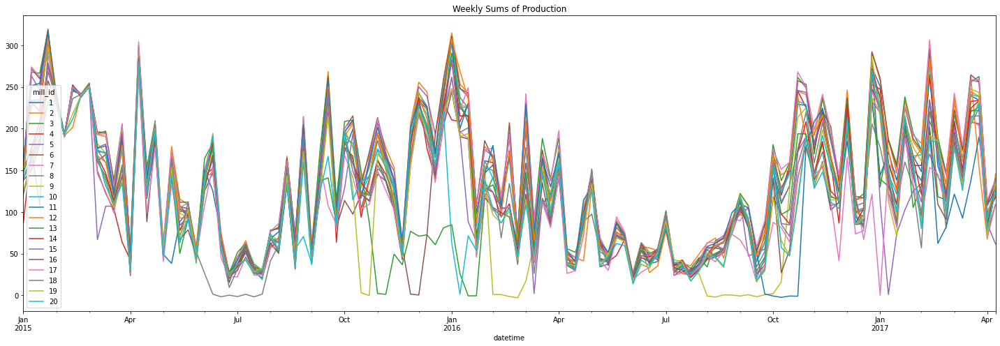

In [57]:
data_prod_weeks_sum.plot(title='Weekly Sums of Production', figsize=(width*2, height))
plt.tight_layout()

Conclusion: 
* We see that for multiple production sites we have 0 production for multiple weeks (e.g. production site 19 from Aug - Sep 2016)
* This could be for an upgrade of the wind site, maintenance or other reasons
* Hence, we keep this in mind for data cleaning

#### Weekly Sums of Forecast

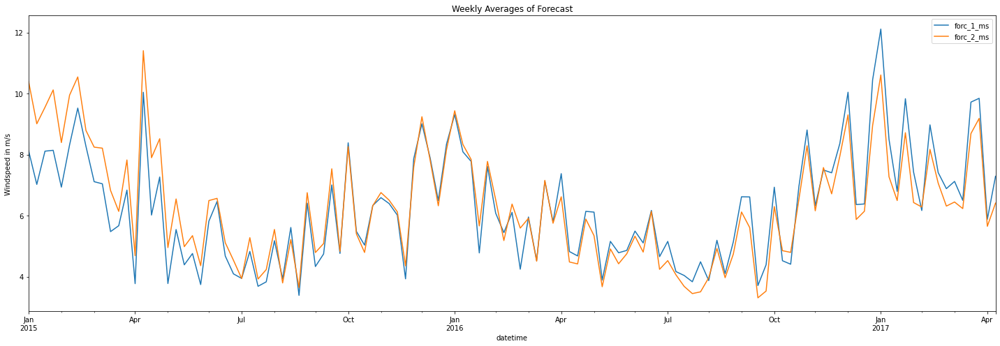

In [58]:
data[['forc_1_ms', 'forc_2_ms']].resample(rule='w').mean().plot(figsize=(width*2, height))
plt.title('Weekly Averages of Forecast')
plt.ylabel('Windspeed in m/s')
plt.tight_layout()

#### Plots of excerpts

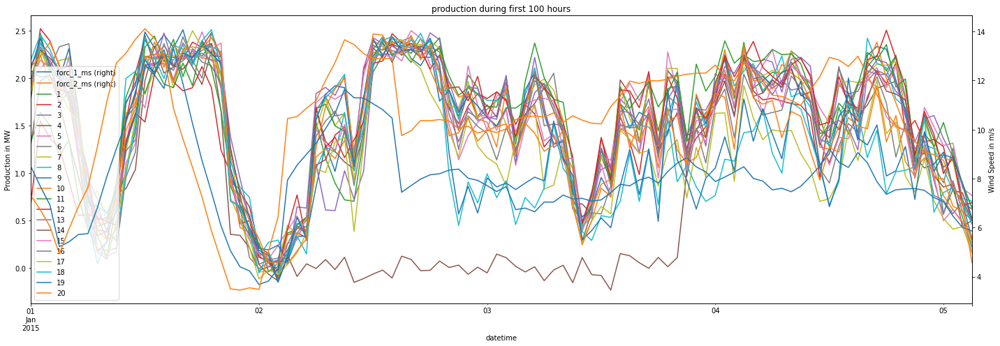

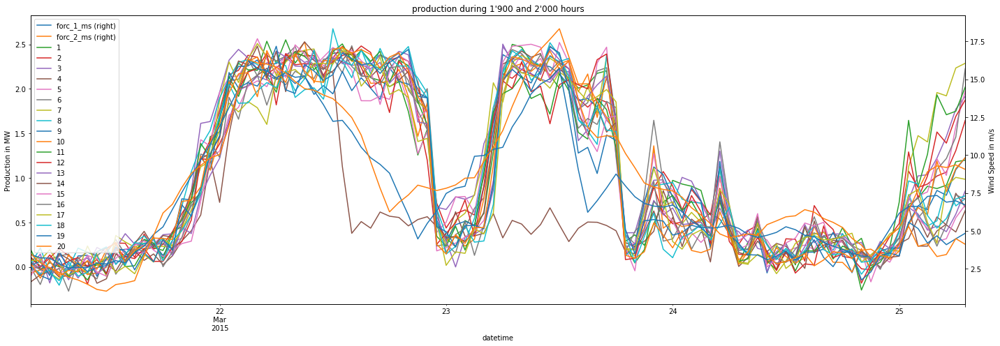

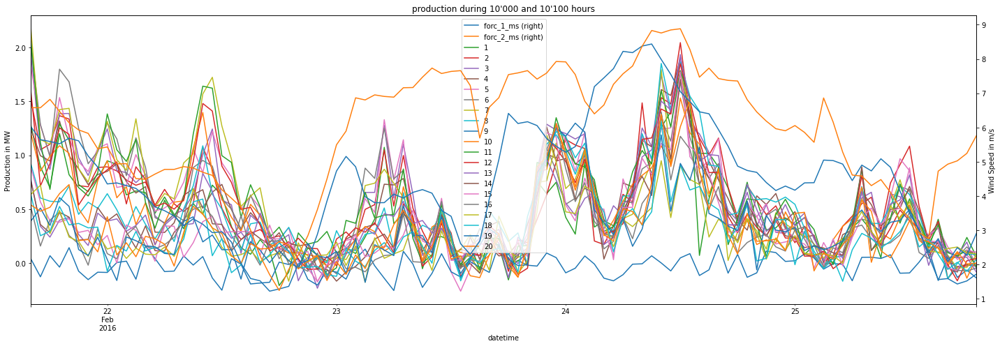

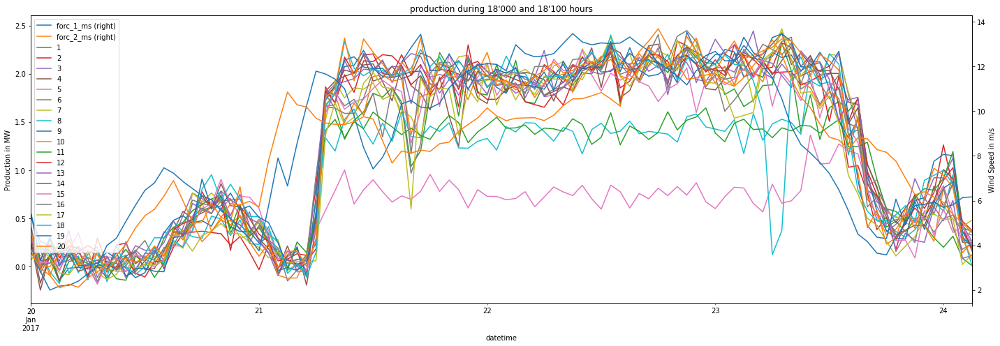

In [59]:
# first 100 hours
ax = data.iloc[:100, ].plot(figsize=(width*2, height), secondary_y=['forc_1_ms', 'forc_2_ms'], title='production during first 100 hours')
ax.set_ylabel('Production in MW')
ax.right_ax.set_ylabel('Wind Speed in m/s')
plt.tight_layout()

# other 100 hours
ax = data.iloc[1900:2000, ].plot(figsize=(width*2, height), secondary_y=['forc_1_ms', 'forc_2_ms'], title="production during 1'900 and 2'000 hours")
ax.set_ylabel('Production in MW')
ax.right_ax.set_ylabel('Wind Speed in m/s')
plt.tight_layout()

#other 100 hours
ax = data.iloc[10000:10100, ].plot(figsize=(width*2, height), secondary_y=['forc_1_ms', 'forc_2_ms'], title="production during 10'000 and 10'100 hours")
ax.set_ylabel('Production in MW')
ax.right_ax.set_ylabel('Wind Speed in m/s')
plt.tight_layout()

#other 100 hours
ax = data.iloc[18000:18100, ].plot(figsize=(width*2, height), secondary_y=['forc_1_ms', 'forc_2_ms'], title="production during 18'000 and 18'100 hours")
ax.set_ylabel('Production in MW')
ax.right_ax.set_ylabel('Wind Speed in m/s')
plt.tight_layout()


### Boxplot Analysis

Box plots are good for an understanding of the distribution. 

Text(0.5, 1.0, '2017 boxplot')

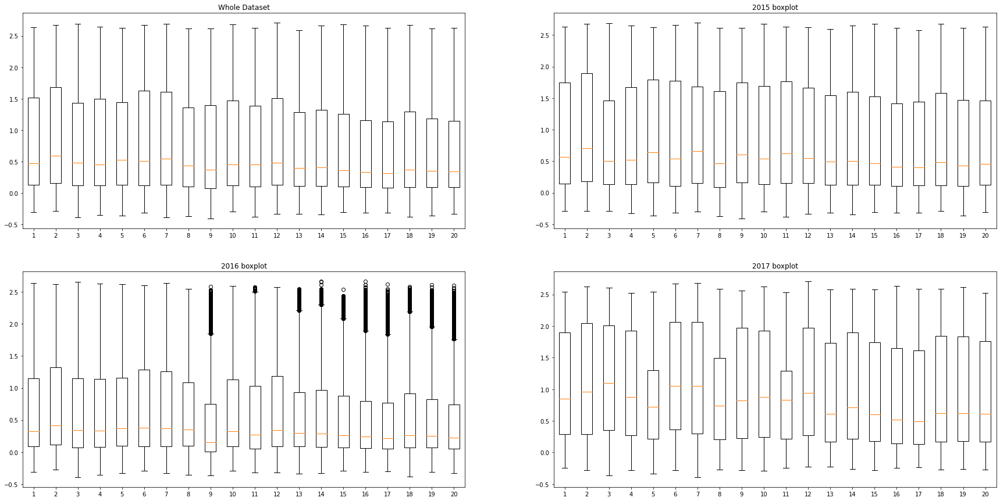

In [60]:
df_2015 = data_prod.loc['2015-01-01 00:00:00':'2015-12-31 23:00:00', ]
df_2016 = data_prod.loc['2016-01-01 00:00:00':'2016-12-31 23:00:00', ]
df_2017 = data_prod.loc['2017-01-01 00:00:00':'2017-12-31 23:00:00', ]

# df_2015.boxplot(figsize=(width, height))
# plt.title('2015 boxplot')

fig, ax = plt.subplots(2, 2, figsize=(30, 15))
ax[0, 0].boxplot(data_prod)
ax[0, 0].set_title('Whole Dataset')

ax[0, 1].boxplot(df_2015)
ax[0, 1].set_title('2015 boxplot')

ax[1, 0].boxplot(df_2016)
ax[1, 0].set_title('2016 boxplot')

ax[1, 1].boxplot(df_2017)
ax[1, 1].set_title('2017 boxplot')

* 2015: 
    * very similar data across all production sites in 2015
* 2016: 
    * seems to be a year, where we had strong deviations. 
    * The mean over all production sites is lower than in 2015
* 2017: 
    * from May to August a decrease in energy production is identified, indicating a seasonality
    * outliers are much more likely in the summer in the UK

### Scatterplots

#### All Data 

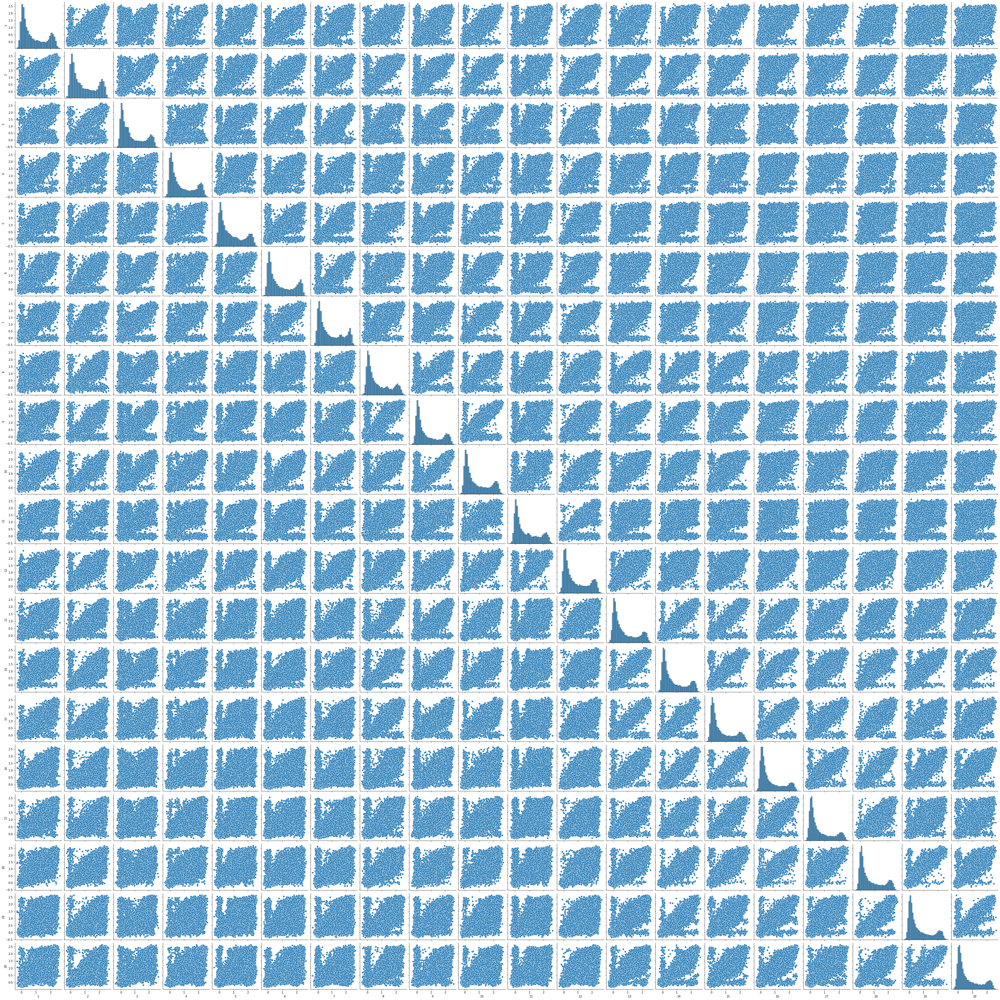

In [61]:
# Hourly Data
sns.pairplot(prod_data)

* Production Scatterplots: with hourly data we find little correlation in between the individual production sites
* Distribution: We see skewed distribution for all production sites. Hence, they are not following a Gaussian distribution, because the peak of energy production is shifted to the left

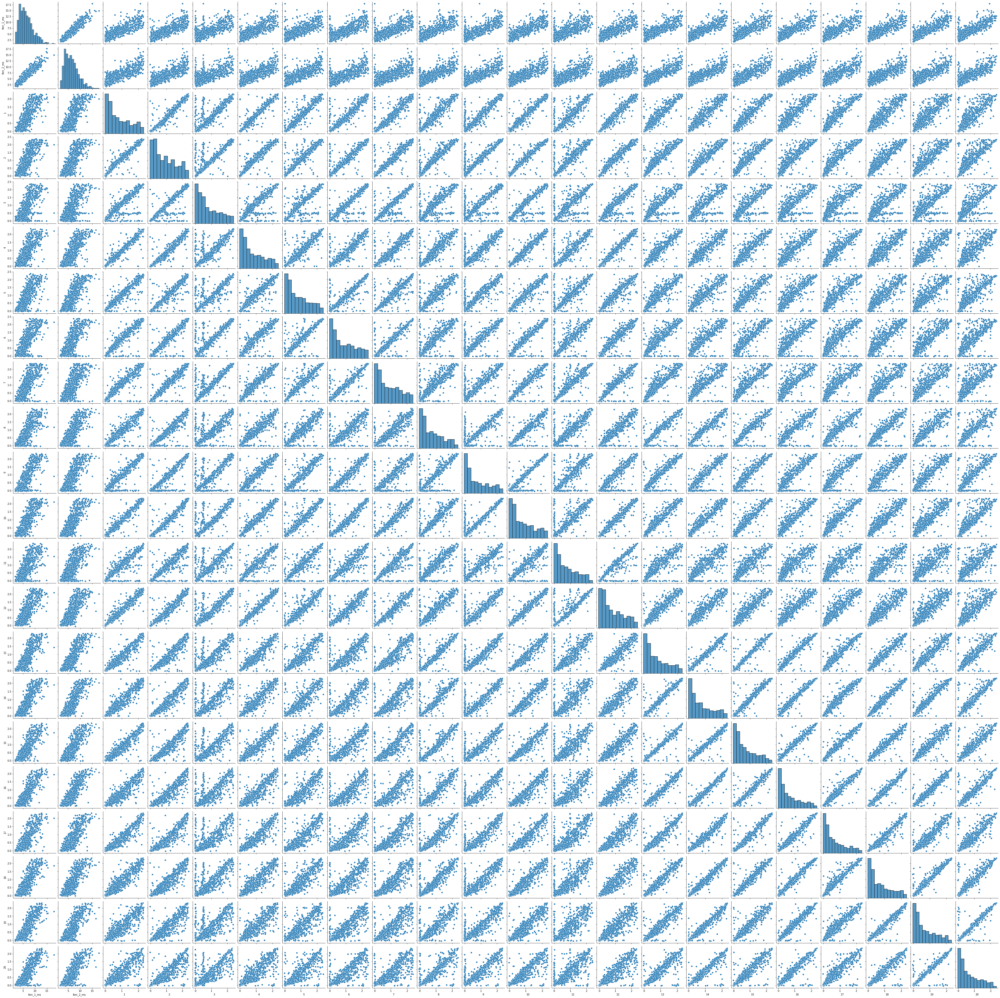

In [62]:
# Daily Data
sns.pairplot(data_days)

* Production Scatter Plots: We can see clear linear relations between individual production sites

#### Forecast vs. Wind Power

(-0.5091665168227645, 2.6)

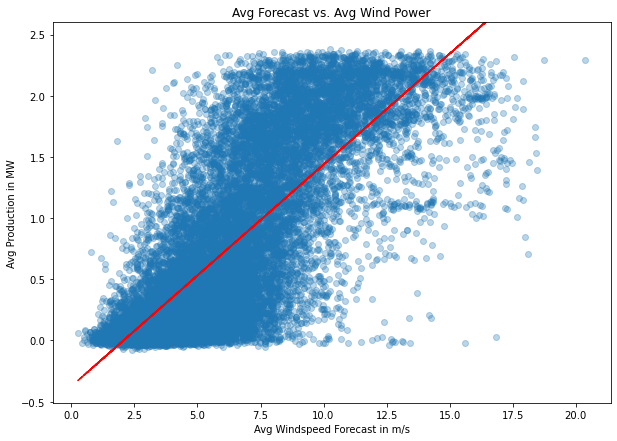

In [63]:
# Aggregated
forc_avg = data[['forc_1_ms', 'forc_2_ms']].mean(axis=1)
prod_avg = data_prod.mean(axis=1)

plt.figure(figsize=(10, 7))
plt.scatter(forc_avg, prod_avg, alpha=0.3)
plt.title('Avg Forecast vs. Avg Wind Power')
plt.xlabel('Avg Windspeed Forecast in m/s')
plt.ylabel('Avg Production in MW')
# add trendline
z = np.polyfit(forc_avg, prod_avg, 1)
p = np.poly1d(z)
plt.plot(forc_avg, p(forc_avg), "r--")
plt.ylim(top=2.6)

Conclusion: 
* We find that there is a cuttoff value above a certain threshold (~2.4MW) where no more energy is produced despite higher wind speeds. It continues in a straight line
straight line when the wind speed reaches ~12.5 m/s (cut-off speed)
* Also, we find that below a certain windspeed, no energy is produced (~7.5 m/s)
* Lastly we find that there are sites with 0 or negative production despite higher wind speeds (e.g. ~0MW at around 12.5 m/s). This may be due to production sites turned off, maintenance or just the wind forecast being inaccurate.

Let's analyze this individually for every forecast and production site.

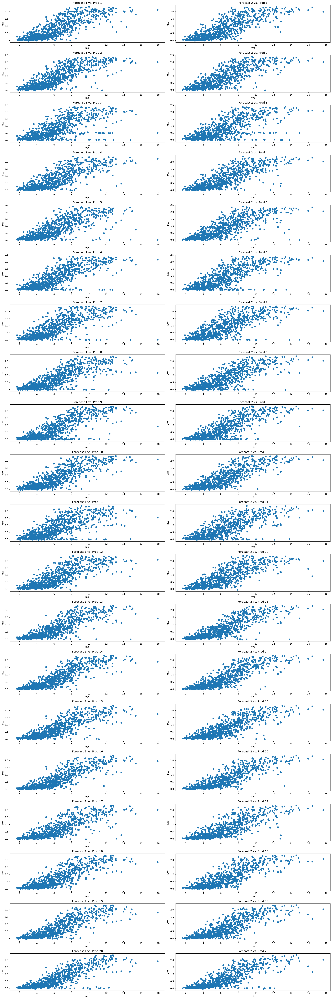

In [64]:
# Individual Plots
cols = [1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20]

def plot_scatters(wind, production, nrows=20, ncols=2):
    fig, ax = plt.subplots(nrows=nrows, ncols=ncols, dpi=120, figsize=(20, 60))
    for i in range(0, len(production.columns)):
        ax[i, 0].scatter(wind['forc_1_ms'], production.iloc[:,i])
        ax[i, 0].set_title('Forecast 1 vs. ' + 'Prod ' + str(production.columns[i]))
        ax[i, 1].scatter(wind['forc_2_ms'], production.iloc[:,i])
        ax[i, 1].set_title('Forecast 2 vs. ' + 'Prod ' + str(production.columns[i]))
    for a in ax.flat:
        a.set(xlabel='m/s', ylabel='MW')
    plt.tight_layout()

plot_scatters(wind=data_days[['forc_1_ms', 'forc_2_ms']], production=data_days[cols])

### Correlation analysis

Text(0.5, 1.0, 'Correlation Heatmap')

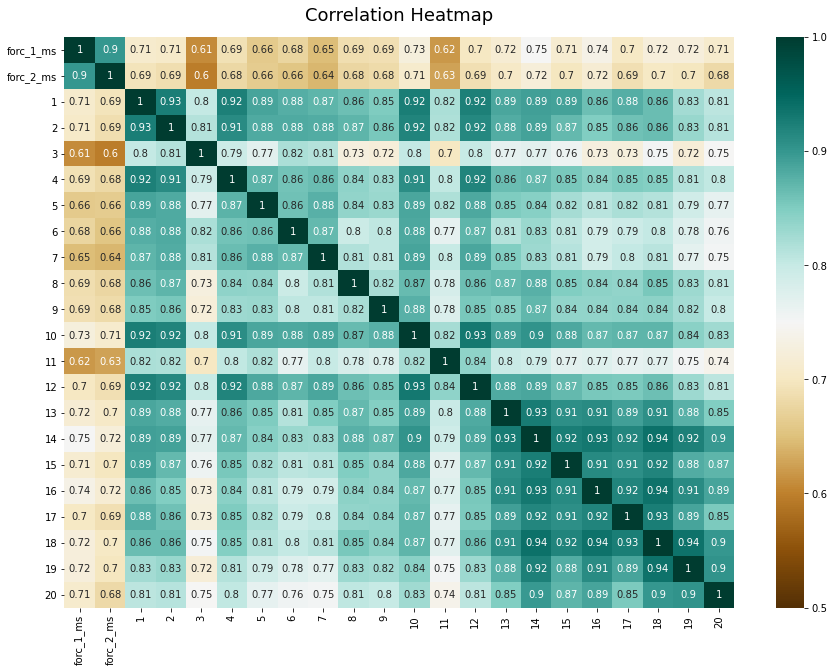

In [65]:
plt.figure(figsize=(width*1.5, height*1.5))

#mask = np.triu(np.ones_like(df_wide.corr(), dtype=np.bool))
heatmap = sns.heatmap(data.corr(), vmin=0.5, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap', fontdict={'fontsize': 18}, pad=16)

Conclusion: 
* All our production sites are very correlated with two light exceptions: Production Site 3 & 11: are slightly less corelated to all other sites and the forecast
* Our Forecast is less correlated with the production outputs. This is to be expected as we are only dealing with the forecast and hence have forecasting errors. 

### Seasonality

What to look out for: 

* Level: is the average value in the series.
* Trend: is the increasing or decreasing value in the series.
* Seasonality: is the repeating the short-term cycle in the series.
* Noise: is the random variation in the series.

There are basically two methods to model the seasonality of a Time Series: additive and multiplicative. Main difference being that additive is linear while multiplicative is non-linear.

* Addittive: 
    * $ y_t = Level + Trend + Seasonality + Noise $
    * does not vary in frequency and amplitude over time (the magnitude of seasonality does not change in relation to time.)
* Multiplicative: 
    * $ y_t = Level * Trend * Seasonality * Noise $
    * does vary in frequency and amplitude over time (the magnitude of seasonality does change in relation to time.)

#### We find yearly seasonality

Text(0, 0.5, 'Average production in MW')

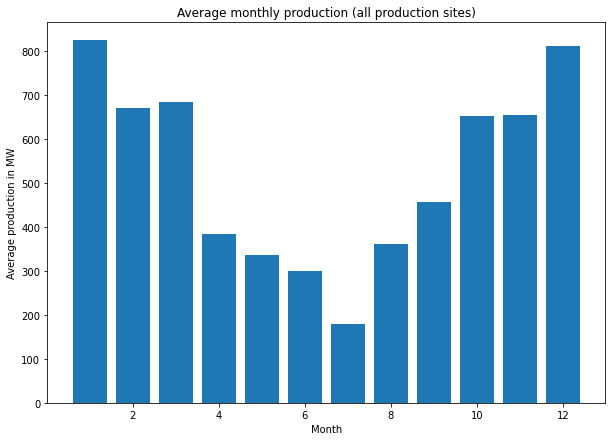

In [66]:
# aggregate across months
df_months = prod_data.resample(rule='m', axis=0, origin='start').sum()
df_weeks = prod_data.resample(rule='w', axis=0, origin='start').sum()
df_days = prod_data.resample(rule='d', axis=0, origin='start').sum()

# aggreagate across production sites
df_avg = df_months.sum(axis=1)
df_avg.index = df_avg.index.date

# aggreagte across months (from multiple years to 12 months)
year_avg = df_months.groupby([df_months.index.month]).mean()

# aggregate from 20 production sites to 1 average
year_avg = year_avg.mean(axis=1) 

# plot
plt.figure(figsize=(width, height))
plt.bar(year_avg.index, year_avg.values)
plt.title('Average monthly production (all production sites)')
plt.xlabel('Month')
plt.ylabel('Average production in MW')

#### We find no monthly seasonality

Text(0, 0.5, 'Average production in MW')

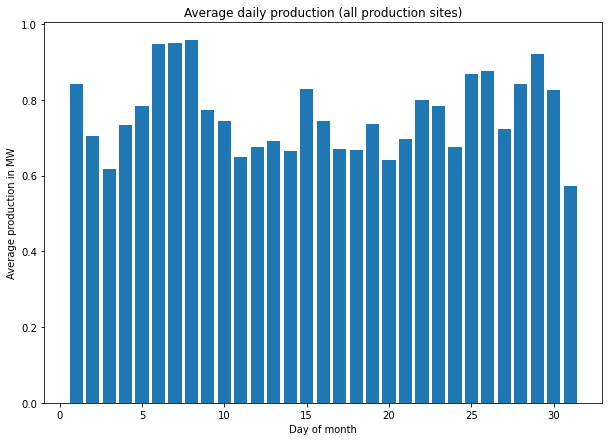

In [67]:
hour_avg = prod_data.mean(axis=1)
day_avg = prod_data.groupby([hour_avg.index.day]).mean()
monthly = day_avg.mean(axis=1)

# plot
plt.figure(figsize=(width, height))
plt.bar(monthly.index, monthly.values)
plt.title('Average daily production (all production sites)')
plt.xlabel('Day of month')
plt.ylabel('Average production in MW')

#### No Daily Seasonality

Text(0, 0.5, 'Average production in MW')

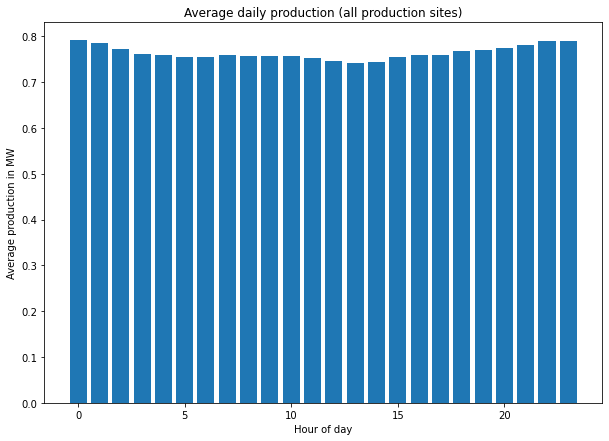

In [68]:
hour_avg = prod_data.mean(axis=1)
hour_avg = prod_data.groupby([hour_avg.index.hour]).mean()
hour_avg = hour_avg.mean(axis=1)

# plot
plt.figure(figsize=(width, height))
plt.bar(hour_avg.index, hour_avg.values)
plt.title('Average daily production (all production sites)')
plt.xlabel('Hour of day')
plt.ylabel('Average production in MW')

#### Dickey Fuller Test for Unit Root (optional)

* $ H_0: non-stationary, unit root $
* $ H_1: stationary $

The more negative this statistic, the more likely we are to reject the null hypothesis of non-stationarity (hence indicating that we have a stationary dataset).
Rejecting the null hypothesis means that the process has no unit root, and in turn that the time series is stationary or does not have time-dependent structure.

In [69]:
def adfuller_test(series, signif=0.05, name='', verbose=False):
    """Perform ADFuller to test for Stationarity of given series and print report"""
    r = adfuller(series, autolag='AIC')
    output = {'test_statistic': round(r[0], 4), 'pvalue': round(
        r[1], 4), 'n_lags': round(r[2], 4), 'n_obs': r[3]}
    p_value = output['pvalue']
    def adjust(val, length=6): return str(val).ljust(length)

    # Print Summary
    print(f'    Augmented Dickey-Fuller Test on "{name}"', "\n   ", '-'*47)
    print(f' Null Hypothesis: Data has unit root. Non-Stationary.')
    print(f' Significance Level    = {signif}')
    print(f' Test Statistic        = {output["test_statistic"]}')
    print(f' No. Lags Chosen       = {output["n_lags"]}')

    for key, val in r[4].items():
        print(f' Critical value {adjust(key)} = {round(val, 3)}')

    if p_value <= signif:
        print(f" => P-Value = {p_value}. Rejecting Null Hypothesis.")
        print(f" => Series is Stationary.")
    else:
        print(
            f" => P-Value = {p_value}. Weak evidence to reject the Null Hypothesis.")
        print(f" => Series is Non-Stationary.")


# Augmented Dickey-Fuller Test
df1 = data_prod.sum(axis=1)
df2 = data_prod_days_sum.sum(axis=1)
df3 = data_prod_weeks_sum.sum(axis=1)
df4 = data_prod_months_sum.sum(axis=1)
name_list = ['hourly', 'daily', 'weekly', 'monthly']
df_list = [df1, df2, df3, df4]

# ADF Test on each df
count = 0
for df in df_list:
    adfuller_test(df, name=name_list[count])
    count += 1
    print('\n')

    Augmented Dickey-Fuller Test on "hourly" 
    -----------------------------------------------
 Null Hypothesis: Data has unit root. Non-Stationary.
 Significance Level    = 0.05
 Test Statistic        = -15.5496
 No. Lags Chosen       = 20
 Critical value 1%     = -3.431
 Critical value 5%     = -2.862
 Critical value 10%    = -2.567
 => P-Value = 0.0. Rejecting Null Hypothesis.
 => Series is Stationary.


    Augmented Dickey-Fuller Test on "daily" 
    -----------------------------------------------
 Null Hypothesis: Data has unit root. Non-Stationary.
 Significance Level    = 0.05
 Test Statistic        = -3.3127
 No. Lags Chosen       = 17
 Critical value 1%     = -3.438
 Critical value 5%     = -2.865
 Critical value 10%    = -2.569
 => P-Value = 0.0143. Rejecting Null Hypothesis.
 => Series is Stationary.


    Augmented Dickey-Fuller Test on "weekly" 
    -----------------------------------------------
 Null Hypothesis: Data has unit root. Non-Stationary.
 Significance Level

### Granger's Causality Test

The Granger's causality test is just to reinsure that our time series are causing each other from a statistical point of view. Hence, we can determin  whether one time series is useful in forecasting anothe

**Interpretation of the output:** 

* If a given p-value is < significance level(0.05), then, the corresponding X series(column) causes the Y(row). 
* For example, P-Value of 0.0003 at(row 1, column 2) represents the p-value of the Grangers Causality test for x1 causing y1, which is less that the significance level of 0.05
* So, you can reject the null hypothesis and conclude x1 causes y1. 

**Conclusion of our table:**
 
* Looking at the P-Values in the above table, I can pretty much observe that all the variables(time series) in the system are interchangeably causing each other

In [71]:
def grangers_causation_matrix(data, variables, test='ssr_chi2test', verbose=False, maxlag=10):
    """Check Granger Causality of all possible combinations of the Time series.
    The rows are the response variable, columns are predictors. The values in the table 
    are the P-Values. P-Values lesser than the significance level (0.05), implies 
    the Null Hypothesis that the coefficients of the corresponding past values is 
    zero, that is, the X does not cause Y can be rejected.

    data      : pandas dataframe containing the time series variables
    variables : list containing names of the time series variables.
    """
    df = pd.DataFrame(np.zeros((len(variables), len(variables))),
                      columns=variables, index=variables)
    for c in df.columns:
        for r in df.index:
            test_result = grangercausalitytests(
                data[[r, c]], maxlag=maxlag, verbose=False)
            p_values = [round(test_result[i+1][0][test][1], 4)
                        for i in range(maxlag)]

            if verbose:
                print(f'Y = {r}, X = {c}, P Values = {p_values}')
            min_p_value = np.min(p_values)
            df.loc[r, c] = min_p_value

    df.columns = [var + '_x' for var in variables]
    df.index = [var + '_y' for var in variables]
    return df


# run test
gcm = grangers_causation_matrix(data, variables=data.columns)
print(gcm)

### Autocorrelation

#### ACF & PACF Plots

/Users/tgraf/opt/anaconda3/envs/py39/lib/python3.9/site-packages/statsmodels/graphics/tsaplots.py:348: FutureWarning: The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.
  warnings.warn(


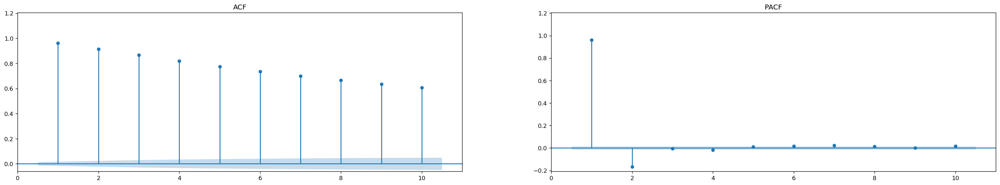

In [ ]:
df = data_prod.sum(axis=1)
fig, ax = plt.subplots(nrows=1, ncols=2, dpi=120, figsize=(30, 5))
sm.graphics.tsa.plot_acf(df, lags=10, ax=ax[0], title='ACF', zero=False, auto_ylims=True)
sm.graphics.tsa.plot_pacf(df, lags=10, ax=ax[1], title='PACF', zero=False, auto_ylims=True)
plt.show()

ACF: 
* As this ACF shows that we never go to zero we might have a trend or seasonality
* this can be mitigated by applying first differences (which we would need for tradtional time series analysis)

PACF: 
* given that the PACF cuts off after 1 lag a simple AR(1) model could be used

#### Ljung Box Test
The Ljung-Box test is a statistical test that checks if autocorrelation exists in a time series.

It uses the following hypotheses:
* H0: The residuals are independently distributed.
* HA: The residuals are not independently distributed; they exhibit serial correlation.

In [ ]:
warnings.filterwarnings('ignore')

df = data_prod.sum(axis=1)

res_1 = sm.tsa.ARIMA(endog=df, order=(1, 0, 0), trend=None).fit()
res_2 = sm.tsa.ARIMA(endog=df, order=(2, 0, 0), trend=None).fit()
res_3 = sm.tsa.ARIMA(endog=df, order=(3, 0, 0), trend=None).fit()

lb_1 = sm.stats.acorr_ljungbox(res_1.resid, lags=[1, 2, 3, 4, 5, 6, 7, 8, 9], return_df=True, boxpierce=True)
lb_2 = sm.stats.acorr_ljungbox(res_2.resid, lags=[1, 2, 3, 4, 5, 6, 7, 8, 9], return_df=True, boxpierce=True)
lb_3 = sm.stats.acorr_ljungbox(res_3.resid, lags=[1, 2, 3, 4, 5, 6, 7, 8, 9], return_df=True, boxpierce=True)

print('\n', 'Ljung Box 1', lb_1)
print('\n', 'Ljung Box 2', lb_2)
print('\n', 'Ljung Box 3', lb_3)

NameError: name 'warnings' is not defined

# Feature Engineering

### Background

**Understanding Wind**

Let's examine the wind to energy production conversion. This tells us that velocity (m/s) is a very important factor in predicting energy production. 
Also the area of the rotor blades is very important for the output. 
I assume that air density and efficiency is relatively similar across all 20 wind production assets given the above analysis. 

$Production = 0.5 * area * velocity^3 * air density * efficiency$
* area = $\pi * r^2$
* air_density = 1.2 (on average for 15 degrees celcius and at sea level)
* efficiency: maximum theoretical possibility of 56.66%, average around 30 - 40%

**Normalizing Data**: 

XGBoost is not sensitive to monotonic transformations of its features for the same reason that decision trees and random forests are not: the model only needs to pick "cut points" on features to split a node. Splits are not sensitive to monotonic transformations: defining a split on one scale has a corresponding split on the transformed scale.

### Dataset A: Production and Forecast Data

This is the raw data which is unprocessed

In [ ]:
# merge df
dataset_a = pd.merge(forc_wide, prod_data, left_on='datetime', right_on='datetime', how='left')

# add 4h in advance production sum as dependent variable
cols = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20]
product_sum = dataset_a[cols].sum(axis=1)
dataset_a['prod_sum'] = product_sum.shift(-4)

# drop values where we have forecasts but no production data
dataset_a.dropna(inplace=True)

# save to csv
dataset_a.to_csv('data_processed/dataset_a.csv')

### Dataset B: Cleaned Production from maintenance, malfunction, errors

Why do we have negative power production sometimes? 
* possibly measurement error
* wind turbines use energy in standby mode and the number represents the net production (produced - consumed energy)

Reasons for no power production: 
* no wind
* malfunction of wind turbine or measurement
* maintenance of wind turbine

Text(0.5, 1.0, 'Daily Cummulative Negative Production for all sites')

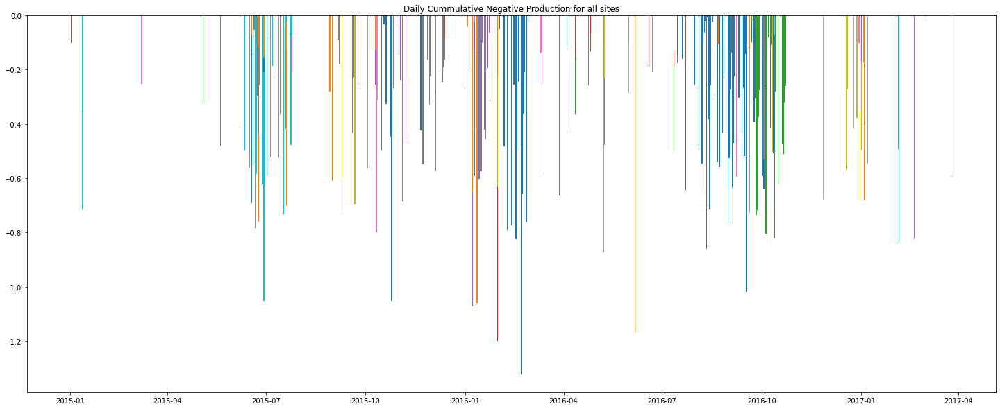

In [ ]:
# Daily
df_merged_days = dataset_a.resample(rule='d', axis=0).sum()
df_merged_neg_days = df_merged_days[df_merged_days < 0].dropna(how='all')
df_merged_neg_days.count()

plt.figure(figsize=(25, 10))
for col in df_merged_neg_days.columns:
    plt.bar(df_merged_neg_days[col].index, df_merged_neg_days[col].values)
plt.title('Daily Cummulative Negative Production for all sites')

Delete all rows with daily cummulative negative productions and where we have above 7.5 m/s wind forecast
* Assumption 1: If we have wind higher than a certain theshold we should have positive production
* Assumption 2: Scheduled wind turbine maintenance is usually completed twice a year, resulting in about 12 to 18 hours of downtime for each maintenance event. Generally, only a few turbines in a facility are down at one time for maintenance activities

In [ ]:
# find days where we have little wind and zero to negative production
a_days = dataset_a.resample(rule='d').mean()
neg_dates = a_days[cols][a_days[cols] < 0].dropna(how='all').index.date

# get forecast in m/s for negative dates and plot to find pattern
forc_neg_avg = a_days.loc[neg_dates][['forc_1_ms', 'forc_2_ms']].mean(axis=1)
prod_neg_avg = a_days.loc[neg_dates][cols].mean(axis=1)
forc_neg = a_days.loc[neg_dates][['forc_1_ms', 'forc_2_ms']]
prod_neg = a_days.loc[neg_dates][cols]
a_days_neg = a_days.loc[neg_dates]

# we assume that when m/s is above 6 and we have negative daily production, that it is not caused by maintenance
# else it may be caused by maintenance or our calculation error
# hence we remove vaues above 6 m/s and negative daily production
neg_days_maint = a_days_neg[(a_days_neg['forc_1_ms'] + a_days_neg['forc_1_ms'] / 2) > 7.5]
neg_days_maint = neg_days_maint.index.date

# delete not needed days
dataset_b = dataset_a.copy()
for date in neg_days_maint:
    dataset_b = dataset_b[dataset_b.index.date != date]

print(f"We have deleted in total {len(dataset_a) - len(dataset_b)} rows ({round((len(dataset_a)-len(dataset_b))/len(dataset_a)*100, 1)}%) from Dataset A")

# save dataset c
dataset_b.to_csv('data_processed/dataset_b.csv')

We have deleted in total 2280 rows (11.5%) from Dataset A


### Dataset C: Add Seasonality as Features

I add the following features: 
* Monthly Average
* Monthly Min
* Monthly Max

To make sure to avoid forward-looking bias I calculate the values using a rolling window after 1 year. I include 1 year to have XGBoost learn to use these seasonality parameters. This means that we have a time-bias for the first year, which is part of the training data. However for the following years including the testing data, we don't have any forward-looking bias.  

_WARNING: This takes a long time to calculate!_

In [ ]:
# dataset_c = dataset_b.copy()
# dataset_c.reset_index(inplace=True)
# dataset_c['month'] = dataset_c['datetime'].dt.month

# # drop values where we have no more than the forecasts
# dataset_c.dropna(inplace=True)

# # as we have data from january 2015 - april 2017 we can include averages for seasonality
# # however we need to avoid forward-looking bias when calculating the average, min, and max
# # hence we calculate the averages fixed for the first two years and then we do a rolling average, min, and max

# def add_features(df):
#     """Adds various features: 
#     * Monthly Avg
#     * Monthly Min
#     * Monthly Max
#     """
#     # average hour per power per month, average
#     month_avg = df.groupby(by=['month']).mean()
#     month_avg.drop(columns=['forc_1_ms', 'forc_2_ms'], inplace=True)
#     month_avg = month_avg.add_suffix('_avg')

#     # min per hour
#     month_min = df.groupby(by=['month']).min()
#     month_min.drop(columns=['forc_1_ms', 'forc_2_ms'], inplace=True)
#     month_min = month_min.add_suffix('_min')

#     # max per hour
#     month_max = df.groupby(by=['month']).max()
#     month_max.drop(columns=['forc_1_ms', 'forc_2_ms'], inplace=True)
#     month_max = month_max.add_suffix('_max')

#     # merge dataframes
#     df = pd.merge(df, month_avg, how='left', left_on='month', right_on=month_avg.index)
#     df = pd.merge(df, month_min, how='left', left_on='month', right_on=month_min.index)
#     df = pd.merge(df, month_max, how='left', left_on='month', right_on=month_max.index)

#     # drop not needed columns
#     df.drop(columns=['datetime_min', 'datetime_max','month'], inplace=True)
#     #df.set_index('datetime', inplace=True)
#     return df

# # calculate the avg, min, max 
# # we split where we will split training and testing 
# split = int(len(dataset_c)*0.8)
# df_year_1n2 = dataset_c.iloc[:split]
# df_year_1n2 = add_features(df_year_1n2)

# # calculate the rolling avg, min, max and add to list
# rolling_values = []
# for t in range(split+1, len(dataset_c)+1):
#     # limit df 
#     df = dataset_c[:t]
#     df = add_features(df=df)
#     rolling_values.append(df[-1:].values.tolist()[0])

# # convert to list and append to orginial dataframe
# rolling_df = pd.DataFrame(rolling_values, columns=list(df_year_1n2.columns))
# dataset_c = df_year_1n2.append(rolling_df)

# # add month to dataset which is time independent!
# dataset_c.set_index('datetime', inplace=True)
# dataset_c['month'] = dataset_c.index.month
# dataset_c['hours'] = dataset_c.index.hour

# # save dataframe
# dataset_c.to_csv('data_processed/dataset_c.csv')

### Dataset D: Add lagged values

In [ ]:
# copy dataset
dataset_d = dataset_c.copy()
cols = ['1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '20']

# # create lagged sums
dataset_d['sum_-1'] = dataset_d[cols].sum(axis=1).shift(1)
dataset_d['sum_-2'] = dataset_d[cols].sum(axis=1).shift(2)
dataset_d['sum_-3'] = dataset_d[cols].sum(axis=1).shift(3)
dataset_d['sum_-4'] = dataset_d[cols].sum(axis=1).shift(4)

# create lagged forecasts
dataset_d['forc_-1'] = (dataset_d['forc_1_ms'].shift(1) + dataset_d['forc_2_ms'].shift(1) ) / 2
dataset_d['forc_-2'] = (dataset_d['forc_1_ms'].shift(1) + dataset_d['forc_2_ms'].shift(2) ) / 2
dataset_d['forc_-3'] = (dataset_d['forc_1_ms'].shift(1) + dataset_d['forc_2_ms'].shift(3) ) / 2
dataset_d['forc_-4'] = (dataset_d['forc_1_ms'].shift(1) + dataset_d['forc_2_ms'].shift(4) ) / 2

# save to csv
dataset_d.to_csv('data_processed/dataset_d.csv')

### Other

Time series data often requires cleaning, scaling, and even transformation.

For example:

* Frequency. Perhaps data is provided at a frequency that is too high to model or is unevenly spaced through time requiring resampling for use in some models.
* Outliers. Perhaps there are corrupt or extreme outlier values that need to be identified and handled.
* Missing. Perhaps there are gaps or missing data that need to be interpolated or imputed.

However, we don't have missing values and we have already filtered the negative outliers most likely due to maintenance or measurement errors

In [ ]:
dataset_a[dataset_a.isnull()].dropna(how='all')

,forc_1_mw,forc_2_mw,forc_1_ms,forc_2_ms,1,2,3,4,5,6,...,11,12,13,14,15,16,17,18,19,20
datetime,,,,,,,,,,,,,,,,,,,,,


# Modeling

### 1. Persistence Model

This model is the most simple. It predicts values in t=5 to be values of t=1, so the values of 4 periods ahead are the same as the values of today

$\hat{y}_{t=4} = y_{t=0}$

In [ ]:
# split test and train
def split_test_train(dataset, split=0.75):
    # split dependent and independent variables
    data = dataset.drop(columns=['prod_sum']).copy()
    label = dataset['prod_sum']

    # split training and testing data
    length = int(split*len(data))

    # add +4h gap so we do have no time bias
    gap = 4
    length_test = length+gap

    x_train = data.iloc[:length, ]
    x_test = data.iloc[length_test:, ]
    y_train = label.iloc[:length, ]
    y_test = label.iloc[length_test:, ]

    # split train and test
    return x_train, x_test, y_train, y_test

# return accuracy metrics for model
def return_accuracy(x_test, y_test, name):
    # calculate RMSE, R2, Adj. R2, STDEV, Error Peak
    actual = y_test.values
    cols = ['1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '20']
    prediction = x_test[cols].sum(axis=1)
    MSE = mse(actual, prediction)
    RMSE = round(np.sqrt(MSE), 4)
    R2 = round(r2_score(actual, prediction), 4)

    # as we have no predictors R2 = R2 ADJ
    R2_ADJ = R2
    STD_DEV = round(np.std(actual), 4)

    result_dict = {name: {'RMSE': RMSE, 'R2': R2,
                          'R2_ADJ': R2_ADJ, 'STD_DEV': STD_DEV}}
    result_df = pd.DataFrame.from_dict(result_dict)

    # create folder if not yet created
    if not os.path.exists('results'):
        os.makedirs('results')

    # save as csv
    result_df.to_csv('results/' + name + '.csv')
    return result_df

# create folder if doesn't yet exist
if not os.path.exists('results'):
    os.makedirs('results')

# split dataset
x_train, x_test, y_train, y_test = split_test_train(dataset_a)

# calculate accuracy
df = return_accuracy(x_test=x_test, y_test=y_test, name='persistence')

# save to csv
df.to_csv('results/persistence.csv')



### 2. Linear Regression

I use a simple linear regression model where I average the forecasts and the production sum to avoid multicollinearity. 

$\hat{y}_{t=4} = c + {\beta_1}_{t=0}*forecast + {\beta_2}_{t=0}*production$

In [ ]:
# return accuracy metrics for model
def return_accuracy(model, x_test, y_test, name):
    # calculate RMSE, R2, Adj. R2, STDEV, Error Peak
    actual = y_test.values
    cols = ['1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '20']
    prediction = model.predict(x_test)
    MSE = mse(actual, prediction)
    RMSE = round(np.sqrt(MSE), 4)
    R2 = round(r2_score(actual, prediction), 4)

    # as we have no predictors R2 = R2 ADJ
    R2_ADJ = R2
    STD_DEV = round(np.std(actual), 4)

    result_dict = {name: {'RMSE': RMSE, 'R2': R2, 'R2_ADJ': R2_ADJ, 'STD_DEV': STD_DEV}}
    result_df = pd.DataFrame.from_dict(result_dict)

    # create folder if not yet created
    if not os.path.exists('results'):
        os.makedirs('results')

    # save as csv
    result_df.to_csv('results/' + name + '.csv')
    return result_df

def average_df(data_x): 
    # average forc 1 & 2 and sum up current production
    x = pd.DataFrame(data_x[['forc_1_ms', 'forc_2_ms']].sum(axis=1) / 2, columns=['forecast'])
    cols = ['1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '20']
    prod_sum_today = data_x[cols].sum(axis=1)
    x['prod_sum'] = prod_sum_today
    return x

# to avoid multicollinearity we sum up production and average forecast
x_train, x_test, y_train, y_test = split_test_train(dataset_a)
x_train = average_df(x_train)

# Train linear regression 
mod = sm.OLS(y_train, x_train)
regr = mod.fit()
print(regr.summary())

# Predict linear regression
x_test = average_df(x_test)
return_accuracy(model=regr, name='OLS', x_test=x_test, y_test=y_test)


NameError: name 'split_test_train' is not defined

### 3. XG Boost

This is the most complex and takes time to compute. Especially the hyperparameter tuning takes time. Therefore I have put the code in a seperate file named 05_xgboost.py

# Evaluation

In [ ]:
warnings.filterwarnings("ignore")

# read csvs
results_a = pd.read_csv('results/dataset_a.csv', names=['metric', 'dataset_a'], header=0)
results_b = pd.read_csv('results/dataset_b.csv', names=['metric', 'dataset_b'], header=0)
results_c = pd.read_csv('results/dataset_c.csv', names=['metric', 'dataset_c'], header=0)
results_d = pd.read_csv('results/dataset_d.csv', names=['metric', 'dataset_d'], header=0)
results_p = pd.read_csv('results/persistence.csv', names=['metric', 'persistence'], header=0)
results_ols = pd.read_csv('results/OLS.csv', names=['metric', 'OLS'], header=0)

# merge csvs
df = pd.merge(results_a, results_b, how='left')
df = pd.merge(df, results_c, how='left')
df = pd.merge(df, results_d, how='left')
df = pd.merge(df, results_ols, how='left')
df = pd.merge(df, results_p, how='left')

def get_improvement(df_imp, df_benchmark):
    # calculate % improvements
    for col in df_merged.columns:
        # for R2 and R2 ADJ
        df_imp[col][0] = (df_merged[col][0]-df_benchmark[0]) / (df_merged[col][0])
        df_imp[col][1] = (df_merged[col][1]-df_benchmark[1]) / (df_merged[col][1])

        # for RMSE
        df_imp[col][2] = ((df_benchmark[2]-df_merged[col][2]) / df_benchmark[2])

    return df_imp

# improvement
df_merged = df[['OLS', 'dataset_a', 'dataset_b', 'dataset_c', 'dataset_d']] 
df_per = df['persistence']
df_imp = df_merged.copy()
df_imp_per = get_improvement(df_imp=df_imp, df_benchmark=df_per)
df_imp_per.index = ['R2', 'R2_ADJ', 'RMSE']

# improvement
df_merged = df[['dataset_a', 'dataset_b', 'dataset_c', 'dataset_d']]
df_ols = df['OLS']
df_imp = df_merged.copy()
df_imp_ols = get_improvement(df_imp=df_imp, df_benchmark=df_ols)
df_imp_ols.index = ['R2', 'R2_ADJ', 'RMSE']

df.set_index('metric', inplace=True)

# print tables
print('Results Absolute\n', df)
print('\n')
print('Improvements to Persistence Model\n', df_imp_per)
print('\n')
print('Improvements to OLS\n', df_imp_ols)

# save to csv
df.to_csv('results/results_abs.csv', index=True)
df_imp.to_csv('results/results_perc.csv', index=True)

# hourly production for comparison
dataset_a = pd.read_csv('data_processed/dataset_a.csv', index_col='datetime')
print(f"STD DEV of Dataset A is: {round(dataset_a['prod_sum'].std())}")


Results Absolute
         dataset_a  dataset_b  dataset_c  dataset_d     OLS  persistence
metric                                                                 
R2         0.7737     0.7805     0.7767     0.7964  0.7207       0.6061
R2_ADJ     0.7727     0.7794     0.7722     0.7918  0.7207       0.6061
RMSE       6.9830     6.9054     6.9662     6.6513  7.7578       9.2132


Improvements to Persistence Model
              OLS  dataset_a  dataset_b  dataset_c  dataset_d
R2      0.159012   0.216621   0.223447   0.219647   0.238950
R2_ADJ  0.159012   0.215608   0.222351   0.215100   0.234529
RMSE    0.157969   0.242066   0.250488   0.243889   0.278068


Improvements to OLS
         dataset_a  dataset_b  dataset_c  dataset_d
R2       0.068502   0.076618   0.072100   0.095053
R2_ADJ   0.067296   0.075314   0.066693   0.089795
RMSE     0.099874   0.109877   0.102039   0.142631
STD DEV of Dataset A is: 15
